In [16]:
import sys
import Topyfic
import pandas as pd
import scanpy as sc
import numpy as np
from scipy import stats
import random
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rcParams['pdf.fonttype'] = 42



In [40]:
my_palette_timepoint = {'PND_04': 'thistle',
                                 'PND_10': 'plum',
                                 'PND_14': 'violet',
                                 'PND_25': 'mediumorchid',
                                 'PND_36': 'darkviolet',
                                 'PNM_02': 'purple',
                                 'PNM_18': 'indigo'}

my_palette_sex = {'Female': 'pink',
                  'Male': 'blue'}

my_palette_tec = {'Parse': '#801b73',
                  '10x': '#00a1df'}

# Fig. S6a

In [17]:
analysis_top_model = Topyfic.read_analysis("../snrna/adrenal/topyfic/analysis_10x_adrenal_15_parse_adrenal_13.p")


Reading Analysis done!


In [18]:
row_color = analysis_top_model.cell_participation.obs[['celltypes', 'subtypes']]
row_color.drop_duplicates(inplace=True)
row_color.reset_index(drop=True, inplace=True)

In [19]:
row_color = analysis_top_model.cell_participation.obs[['celltypes', 'subtypes']]
row_color.drop_duplicates(inplace=True)
row_color.reset_index(drop=True, inplace=True)
col = ['Cortex',
       'Medulla',
       'Endothelial',
       'Adipocyte',
       'Stromal',
       'Macrophage',
       'Fibroblast',
       'Sox10',
       'Smooth_muscle',
       'Capsule',
       'Skeletal_muscle',
       'Hepatocyte']

row_color.celltypes = pd.Categorical(row_color.celltypes, categories=col)
row_color.sort_values(by='celltypes', axis=0, inplace=True)
row_color.reset_index(drop=True, inplace=True)

row_color.subtypes = pd.Categorical(row_color.subtypes, categories=[
                                                                    'Cortex_cycling',
                                                                    'Cortex_ZG',
                                                                    'Cortex_ZF',
                                                                    'Male_only_ZF',
                                                                    'X_zone',
                                                                    'Medulla_early',
                                                                    'Medulla_NE',
                                                                    'Medulla_EPI',
                                                                    'Endothelial_cycling',
                                                                    'Endothelial',
                                                                    'Adipocyte_cycling',
                                                                    'Adipocyte',
                                                                    'Stromal',
                                                                    'Macrophage',
                                                                    'Fibroblast',
                                                                    'Sox10',
                                                                    'Smooth_muscle',
                                                                    'Capsule',
                                                                    'Skeletal_muscle',
                                                                    'Hepatocyte'
                                                                   ])

color = pd.read_csv("data/enc4_mouse_snrna_celltypes.csv")
row_color['color'] = ""
for i in range(row_color.shape[0]):
    tmp = color.celltype_color[color.celltypes == row_color.loc[i, 'celltypes']].values
    row_color.loc[i, 'color'] = tmp[0]

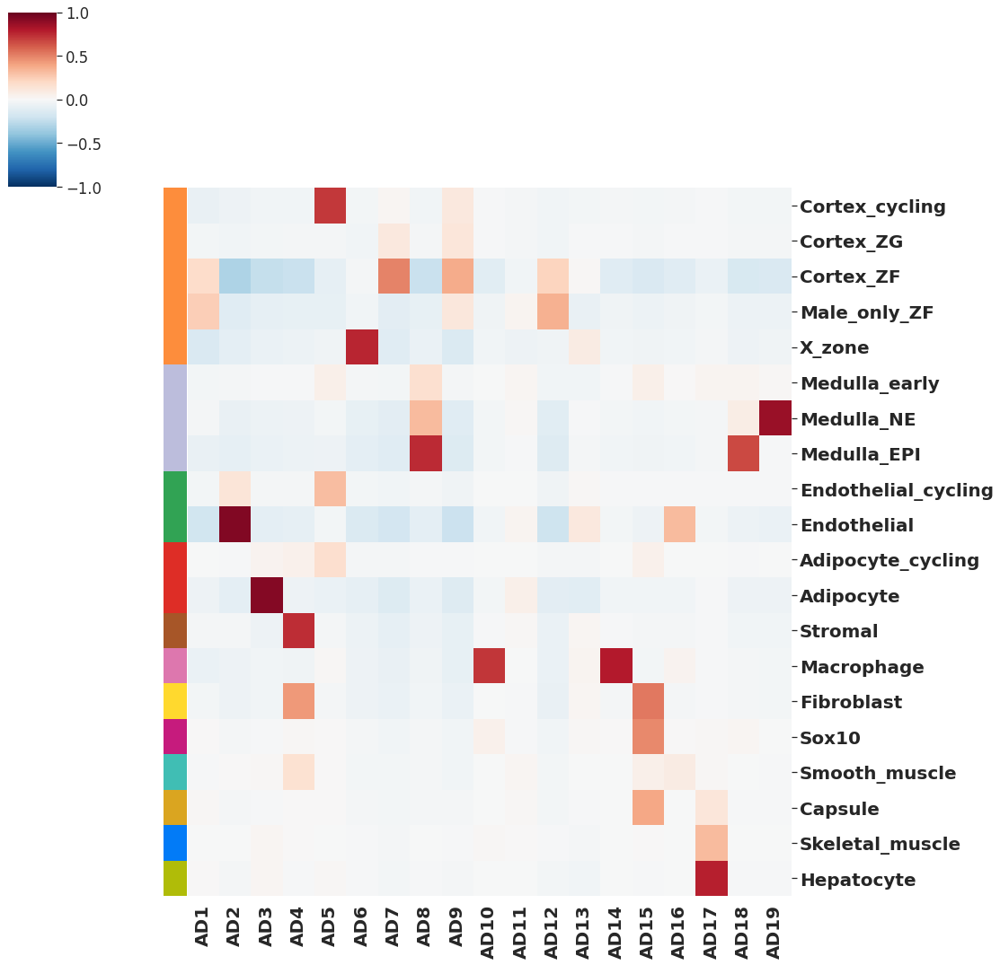

In [20]:
from scipy import stats
import matplotlib.pyplot as plt
import seaborn as sns

datTraits = Topyfic.Analysis.convertDatTraits(analysis_top_model.cell_participation.obs[['subtypes']])

topicsTraitCor = pd.DataFrame(index=analysis_top_model.cell_participation.to_df().columns,
                                      columns=datTraits.columns,
                                      dtype="float")
topicsTraitPvalue = pd.DataFrame(index=analysis_top_model.cell_participation.to_df().columns,
                                         columns=datTraits.columns,
                                         dtype="float")

for i in analysis_top_model.cell_participation.to_df().columns:
    for j in datTraits.columns:
        tmp = stats.pearsonr(analysis_top_model.cell_participation.to_df()[i], datTraits[j], alternative='greater')
        topicsTraitCor.loc[i, j] = tmp[0]
        topicsTraitPvalue.loc[i, j] = tmp[1]

topicsTraitCor = topicsTraitCor.T
topicsTraitCor.index = pd.CategoricalIndex(topicsTraitCor.index, categories=row_color.subtypes.values)
topicsTraitCor.sort_index(level=0, inplace=True)

xlabels = [f"AD{i+1}" for i in range(analysis_top_model.cell_participation.shape[1])]
ylabels = topicsTraitCor.index

sns.set(font_scale=1.5)
res = sns.clustermap(topicsTraitCor, row_colors=row_color['color'].tolist(), cmap='RdBu_r', 
                          vmin=-1, vmax=1, annot_kws={'size': 20, "weight": "bold"},
                          xticklabels=xlabels, yticklabels=ylabels,
                    figsize=(15,15),
                    col_cluster=False, row_cluster=False)
res.ax_heatmap.axes.set_xticklabels(res.ax_heatmap.axes.get_xmajorticklabels(), fontsize=20, fontweight="bold", rotation=90)
res.ax_heatmap.axes.set_yticklabels(res.ax_heatmap.axes.get_ymajorticklabels(), fontsize=20, fontweight="bold")
plt.yticks(rotation=0)
#ax.set_facecolor('white')

plt.savefig("supp_fig6-10/supp_fig6_topictraithmap_adrenal.pdf", bbox_inches='tight')
plt.show()

# Fig. S6b

In [28]:
metadata = pd.read_csv("../snrna/adrenal/seurat/adrenal_Parse_10x_integrated_metadata.csv")

analysis_top_model = Topyfic.read_analysis("../snrna/adrenal/topyfic/analysis_10x_adrenal_15_parse_adrenal_13.p")

my_palette = {'timepoint' : my_palette_timepoint,
              'sex': my_palette_sex,
              'technology': my_palette_tec}

analysis_top_model.colors_topics.index = [f"AD{i+1}" for i in range(analysis_top_model.colors_topics.shape[0])]
analysis_top_model.cell_participation.var.index = [f"AD{i+1}" for i in range(analysis_top_model.cell_participation.shape[1])]


Reading Analysis done!


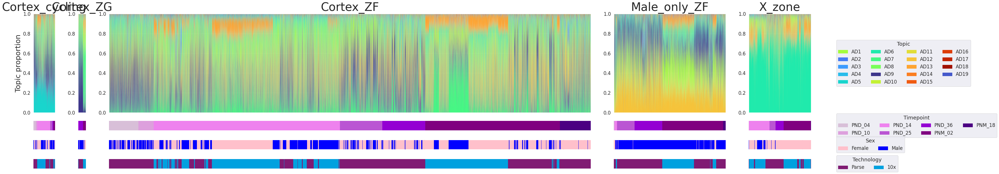

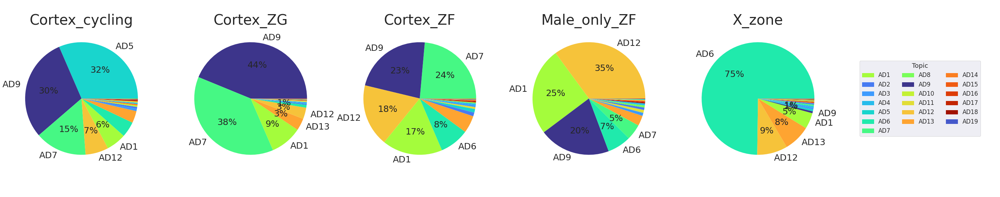

In [29]:
subtypes = ['Cortex_cycling', 'Cortex_ZG','Cortex_ZF','Male_only_ZF','X_zone']
file_name = "supp_fig6-10/supp_fig6_structure_adrenal_cortex"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], 
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig6_pie_adrenal_cortex"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



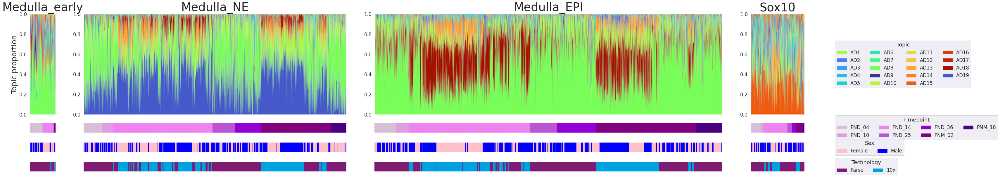

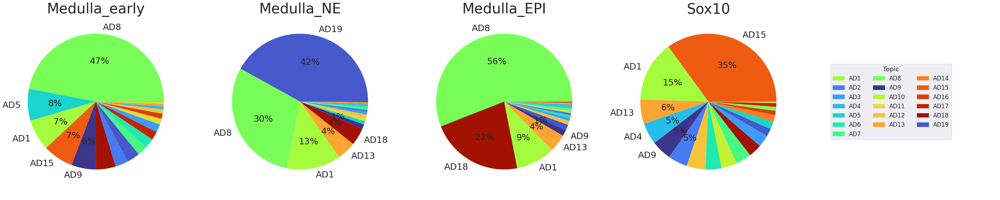

In [31]:
subtypes = ['Medulla_early', 'Medulla_NE','Medulla_EPI','Sox10']
file_name = "supp_fig6-10/supp_fig6_structure_adrenal_medulla"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"],
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig6_pie_adrenal_medulla"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



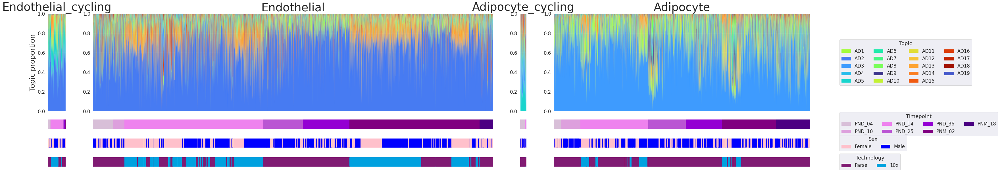

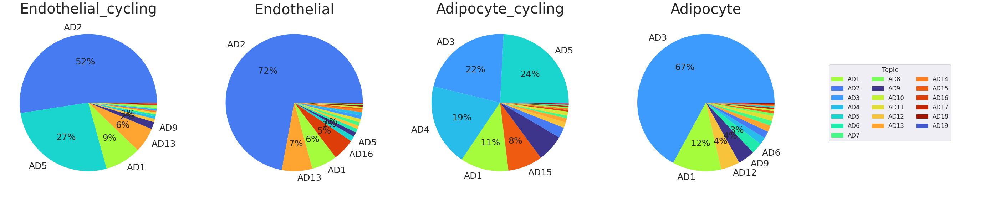

In [32]:
subtypes = ['Endothelial_cycling', 'Endothelial','Adipocyte_cycling','Adipocyte']
file_name = "supp_fig6-10/supp_fig6_structure_adrenal_endo_adipo"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], 
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig6_pie_adrenal_endo_adipo"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



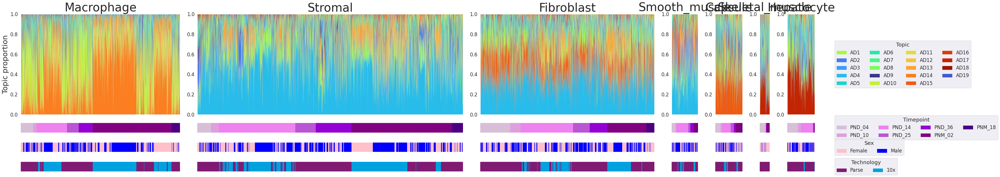

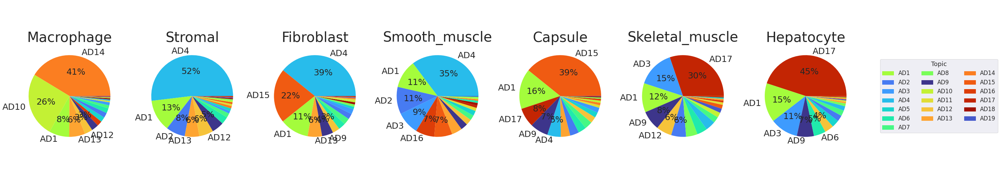

In [34]:
subtypes = ['Macrophage', 'Stromal','Fibroblast','Smooth_muscle','Capsule','Skeletal_muscle','Hepatocyte']
file_name = "supp_fig6-10/supp_fig6_structure_adrenal_other"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], 
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig6_pie_adrenal_other"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



# Fig. S7a

In [35]:
analysis_top_model = Topyfic.read_analysis("../snrna/cortex/topyfic/analysis_10x_cortex_14_parse_cortex_13.p")


Reading Analysis done!


In [36]:
row_color = analysis_top_model.cell_participation.obs[['celltypes', 'subtypes']]
row_color.drop_duplicates(inplace=True)
row_color.reset_index(drop=True, inplace=True)

In [37]:
row_color = analysis_top_model.cell_participation.obs[['celltypes', 'subtypes']]
row_color.drop_duplicates(inplace=True)
row_color.reset_index(drop=True, inplace=True)
col = ['Glutamatergic',
       'GABAergic',
       'OPC',
       'Oligodendrocyte',
       'Astrocyte',
       'Microglia',
       'Endothelial',
       'VLMC',
       'Pericyte']

row_color.celltypes = pd.Categorical(row_color.celltypes, categories=col)
row_color.sort_values(by='celltypes', axis=0, inplace=True)
row_color.reset_index(drop=True, inplace=True)
row_color.subtypes = pd.Categorical(row_color.subtypes, categories=[
                                                                    'L2/3_IT',
                                                                    'L2/3_IT_PPP',
                                                                    'L3_IT_ENT',
                                                                    'L4_IT',
                                                                    'L5_IT',
                                                                    'L5_PT',
                                                                    'L6_IT',
                                                                    'L6/6b_CT',
                                                                    'NP_SUB',
                                                                    'Car3',
                                                                    'Glut_early',
                                                                    'Sst',
                                                                    'Vip',
                                                                    'Pvalb',
                                                                    'Lamp5',
                                                                    'Meis2',
                                                                    'GABA_early',
                                                                    'OPC',
                                                                    'COP',
                                                                    'MFOL',
                                                                    'MOL',
                                                                    'Astrocyte',
                                                                    'Microglia',
                                                                    'Endothelial',
                                                                    'VLMC',
                                                                    'Pericyte'
                                                                   ])

color = pd.read_csv("data/enc4_mouse_snrna_celltypes.csv")
row_color['color'] = ""
for i in range(row_color.shape[0]):
    tmp = color.celltype_color[color.celltypes == row_color.loc[i, 'celltypes']].values
    row_color.loc[i, 'color'] = tmp[0]

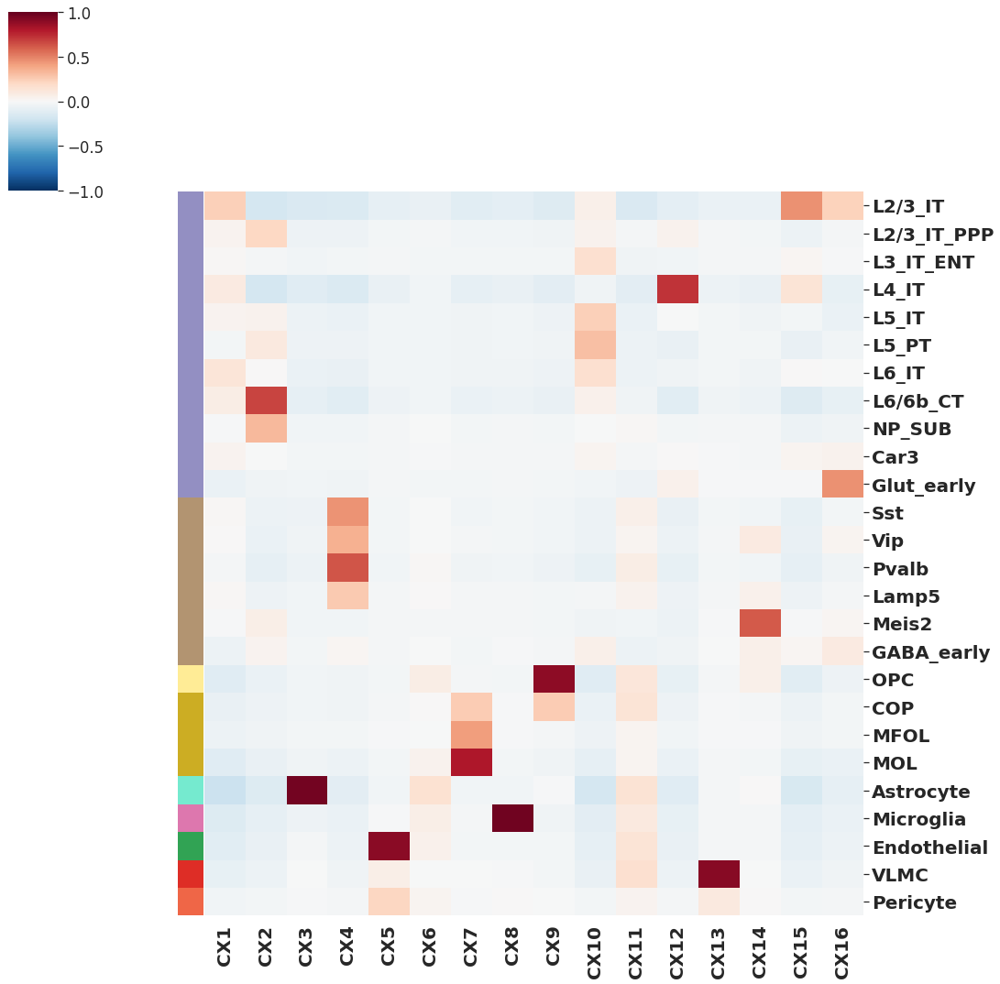

In [38]:
from scipy import stats
import matplotlib.pyplot as plt
import seaborn as sns

datTraits = Topyfic.Analysis.convertDatTraits(analysis_top_model.cell_participation.obs[['subtypes']])

topicsTraitCor = pd.DataFrame(index=analysis_top_model.cell_participation.to_df().columns,
                                      columns=datTraits.columns,
                                      dtype="float")
topicsTraitPvalue = pd.DataFrame(index=analysis_top_model.cell_participation.to_df().columns,
                                         columns=datTraits.columns,
                                         dtype="float")

for i in analysis_top_model.cell_participation.to_df().columns:
    for j in datTraits.columns:
        tmp = stats.pearsonr(analysis_top_model.cell_participation.to_df()[i], datTraits[j], alternative='greater')
        topicsTraitCor.loc[i, j] = tmp[0]
        topicsTraitPvalue.loc[i, j] = tmp[1]

topicsTraitCor = topicsTraitCor.T
topicsTraitCor.index = pd.CategoricalIndex(topicsTraitCor.index, categories=row_color.subtypes.values)
topicsTraitCor.sort_index(level=0, inplace=True)

xlabels = [f"CX{i+1}" for i in range(analysis_top_model.cell_participation.shape[1])]
ylabels = topicsTraitCor.index

sns.set(font_scale=1.5)
res = sns.clustermap(topicsTraitCor, row_colors=row_color['color'].tolist(), cmap='RdBu_r', 
                          vmin=-1, vmax=1, annot_kws={'size': 20, "weight": "bold"},
                          xticklabels=xlabels, yticklabels=ylabels,
                    figsize=(15,15),
                    col_cluster=False, row_cluster=False)
res.ax_heatmap.axes.set_xticklabels(res.ax_heatmap.axes.get_xmajorticklabels(), fontsize=20, fontweight="bold", rotation=90)
res.ax_heatmap.axes.set_yticklabels(res.ax_heatmap.axes.get_ymajorticklabels(), fontsize=20, fontweight="bold")
plt.yticks(rotation=0)
#ax.set_facecolor('white')

plt.savefig("supp_fig6-10/supp_fig7_topictraithmap_cortex.pdf", bbox_inches='tight')
plt.show()

# Fig. S7b

In [47]:
metadata = pd.read_csv("../snrna/cortex/seurat/cortex_Parse_10x_integrated_metadata.csv")

analysis_top_model = Topyfic.read_analysis("../snrna/cortex/topyfic/analysis_10x_cortex_14_parse_cortex_13.p")

my_palette = {'timepoint' : my_palette_timepoint,
              'sex': my_palette_sex,
              'technology': my_palette_tec}

analysis_top_model.colors_topics.index = [f"CX{i+1}" for i in range(analysis_top_model.colors_topics.shape[0])]
analysis_top_model.cell_participation.var.index = [f"CX{i+1}" for i in range(analysis_top_model.cell_participation.shape[1])]



Reading Analysis done!


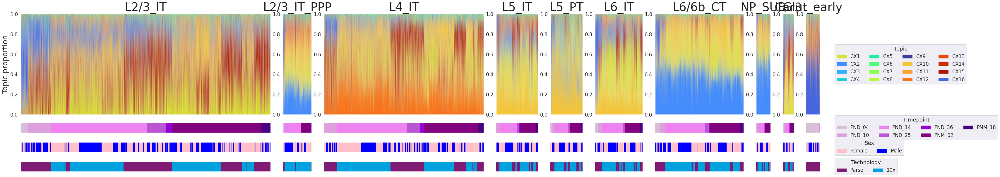

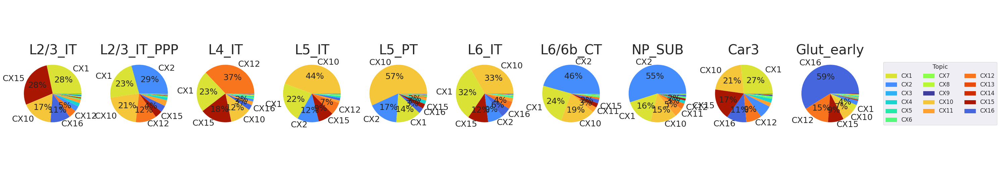

In [48]:
subtypes = ['L2/3_IT', 'L2/3_IT_PPP','L4_IT','L5_IT','L5_PT',
            'L6_IT','L6/6b_CT','NP_SUB','Car3','Glut_early']
file_name = "supp_fig6-10/supp_fig7_structure_cortex_glutamatergic"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig7_pie_cortex_glutamatergic"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



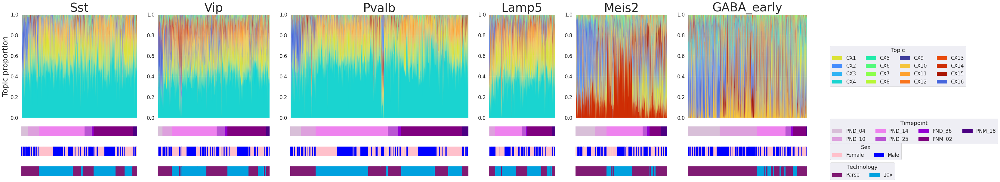

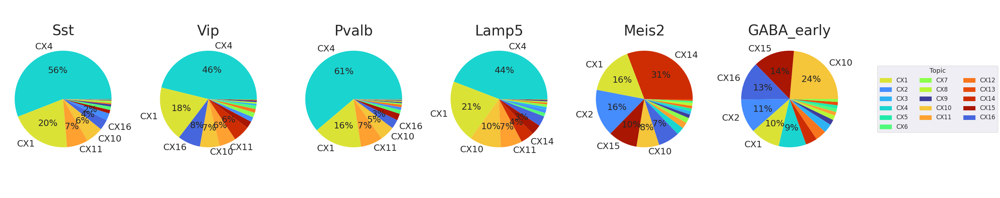

In [49]:
subtypes = ['Sst', 'Vip','Pvalb','Lamp5','Meis2','GABA_early']

file_name = "supp_fig6-10/supp_fig7_structure_cortex_gabaergic"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig7_pie_cortex_gabaergic"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



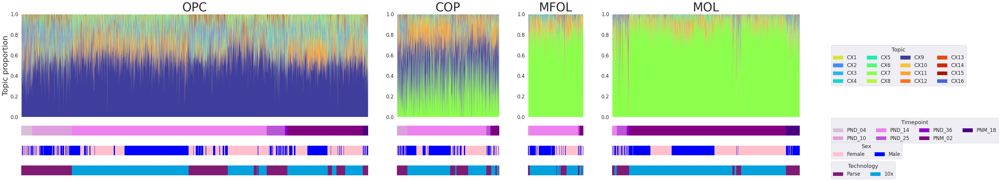

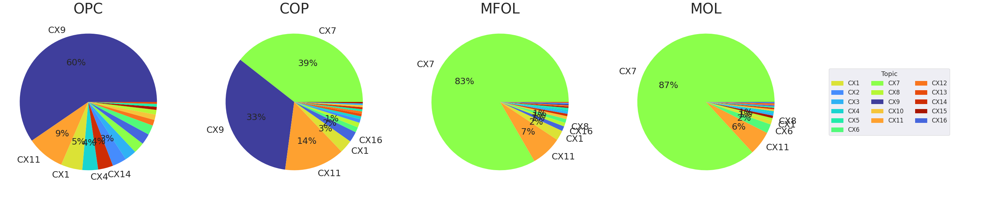

In [50]:
subtypes = ['OPC', 'COP','MFOL','MOL']

file_name = "supp_fig6-10/supp_fig7_structure_cortex_opc_oligo"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig7_pie_cortex_opc_oligo"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



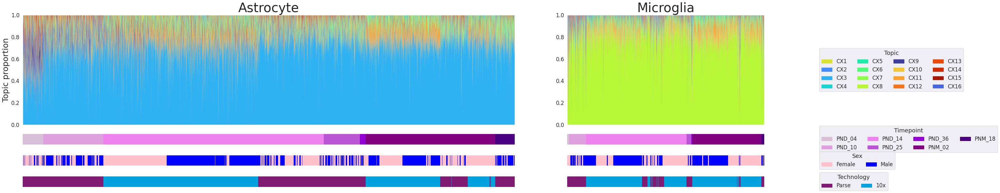

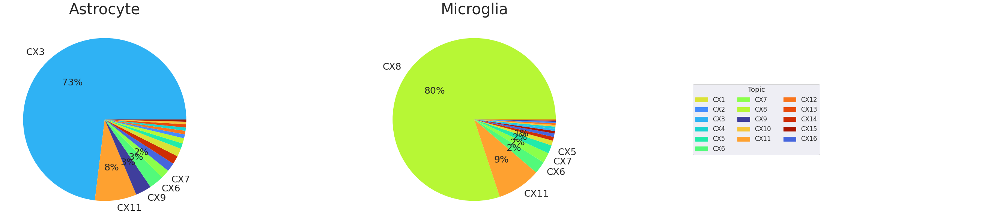

In [51]:
subtypes = ['Astrocyte','Microglia']

file_name = "supp_fig6-10/supp_fig7_structure_cortex_glia"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig7_pie_cortex_glia"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



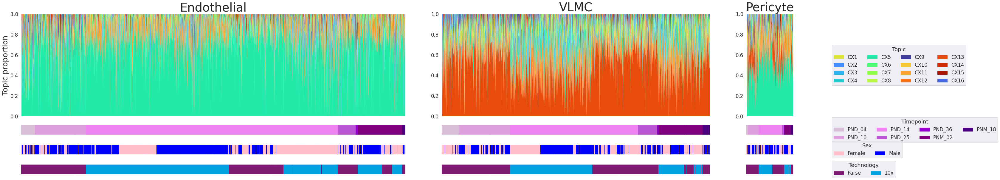

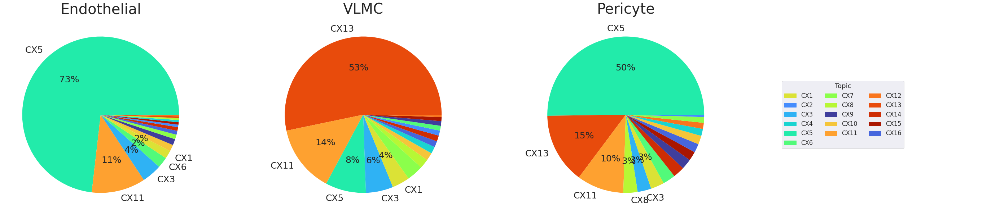

In [52]:
subtypes = ['Endothelial','VLMC', 'Pericyte']

file_name = "supp_fig6-10/supp_fig7_structure_cortex_other"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig7_pie_cortex_other"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



# Fig. S8a

In [23]:
metadata = pd.read_csv("../snrna/hippocampus/seurat/hippocampus_Parse_10x_integrated_metadata.csv")

analysis_top_model = Topyfic.read_analysis("../snrna/hippocampus/topyfic/analysis_10x_hipp_13_parse_hipp_12.p")


my_palette_timepoint = {'PND_04': 'thistle',
                                 'PND_10': 'plum',
                                 'PND_14': 'violet',
                                 'PND_25': 'mediumorchid',
                                 'PND_36': 'darkviolet',
                                 'PNM_02': 'purple',
                                 'PNM_18': 'indigo'}

my_palette_sex = {'Female': 'pink',
                  'Male': 'blue'}

my_palette_tec = {'Parse': '#801b73',
                  '10x': '#00a1df'}

norm = mpl.colors.Normalize(vmin=metadata['monocle3_pseudotime'].min(), 
                            vmax=metadata['monocle3_pseudotime'].max())
my_palette_monocle3_pseudotime = mpl.cm.ScalarMappable(norm=norm, cmap='viridis')

my_palette = {'monocle3_pseudotime': my_palette_monocle3_pseudotime,
              'timepoint' : my_palette_timepoint,
              'sex': my_palette_sex,
              'technology': my_palette_tec}

analysis_top_model.colors_topics.index = [f"HC{i+1}" for i in range(analysis_top_model.colors_topics.shape[0])]
analysis_top_model.cell_participation.var.index = [f"HC{i+1}" for i in range(analysis_top_model.cell_participation.shape[1])]

analysis_top_model.colors_topics.colors["HC9"] = "#00fe35"
analysis_top_model.colors_topics.colors["HC2"] = "#3c41ab"
analysis_top_model.colors_topics.colors["HC5"] = "#00c5e3"
analysis_top_model.colors_topics.colors["HC10"] = "#00f77b"
analysis_top_model.colors_topics.colors["HC7"] = "#f05c13"
analysis_top_model.colors_topics.colors["HC4"] = "#ffbc25"

Reading Analysis done!


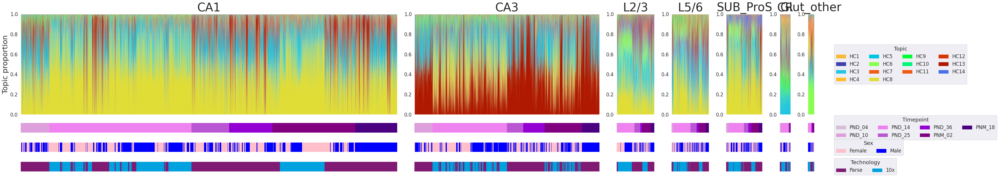

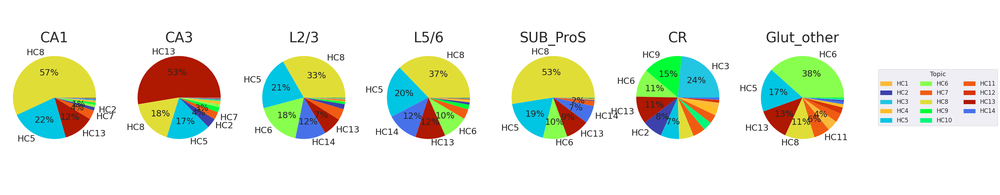

In [24]:
subtypes = ['CA1', 'CA3','L2/3','L5/6','SUB_ProS','CR','Glut_other']
file_name = "supp_fig6-10/supp_fig8_structure_hippocampus_glutamatergic"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig8_pie_hippocampus_glutamatergic"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



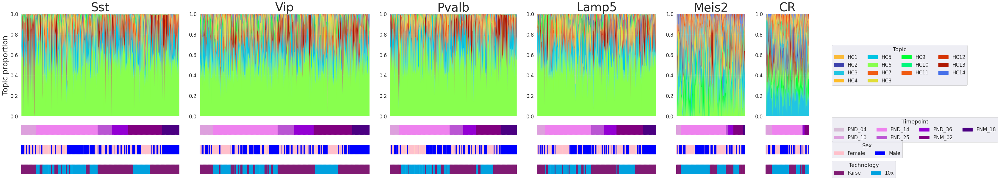

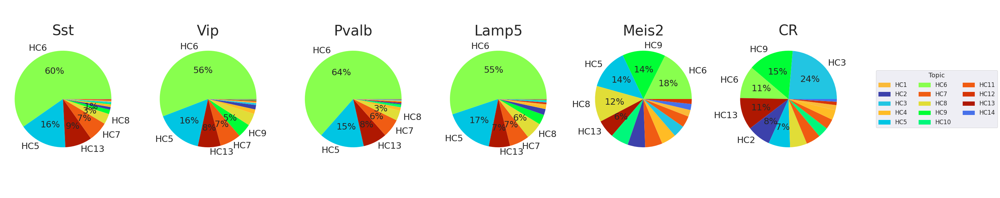

In [25]:
subtypes = ['Sst', 'Vip','Pvalb','Lamp5','Meis2','CR']
file_name = "supp_fig6-10/supp_fig8_structure_hippocampus_gabaergic"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)
file_name = "supp_fig6-10/supp_fig8_pie_hippocampus_gabaergic"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)




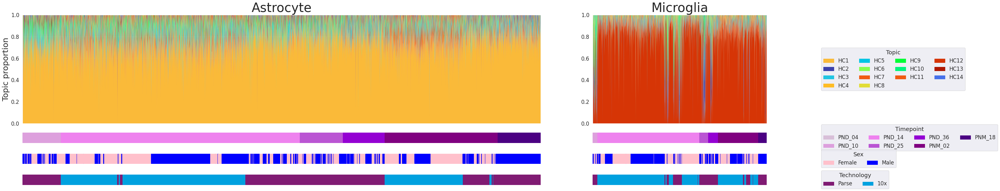

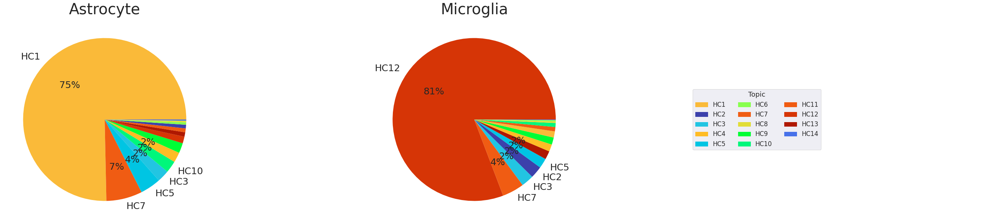

In [26]:
subtypes = ['Astrocyte', 'Microglia']
file_name = "supp_fig6-10/supp_fig8_structure_hippocampus_glia"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)
file_name = "supp_fig6-10/supp_fig8_pie_hippocampus_glia"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)

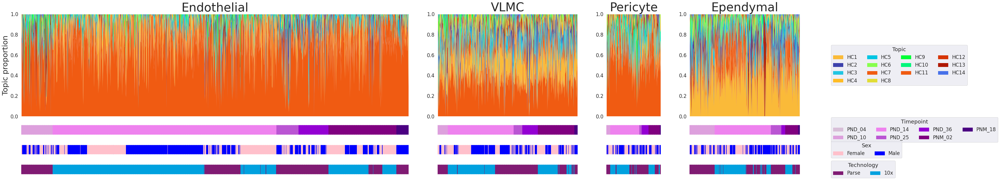

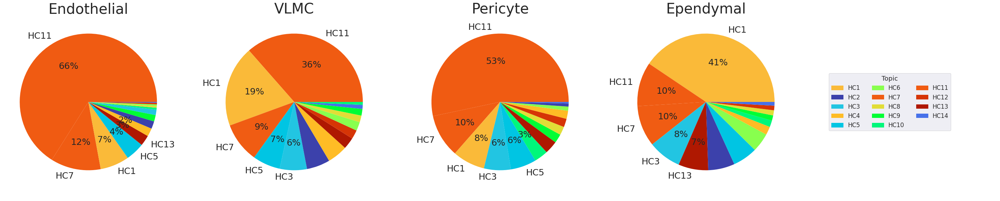

In [27]:
subtypes = ['Endothelial', 'VLMC', 'Pericyte', 'Ependymal']
file_name = "supp_fig6-10/supp_fig8_structure_hippocampus_glia"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)
file_name = "supp_fig6-10/supp_fig8_pie_hippocampus_glia"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)

# Fig. S9a

In [95]:
analysis_top_model = Topyfic.read_analysis("../snrna/heart/topyfic/analysis_10x_heart_11_parse_heart_13.p")



Reading Analysis done!


In [96]:
row_color = analysis_top_model.cell_participation.obs[['celltypes', 'subtypes']]
row_color.drop_duplicates(inplace=True)
row_color.reset_index(drop=True, inplace=True)

In [97]:
#row_color.celltypes.value_counts()
#row_color.subtypes.value_counts()

In [98]:
row_color = analysis_top_model.cell_participation.obs[['celltypes', 'subtypes']]
row_color.drop_duplicates(inplace=True)
row_color.reset_index(drop=True, inplace=True)
col = ['Cardiomyocyte',
       'Endothelial',
       'Fibroblast',
       'Pericyte',
       'Smooth_muscle',
       'Macrophage',
       'Lymphocyte',
       'Adipocyte',
       'Endocardial',
       'Epicardial',
       'Lymphatic_endothelial',
       'Schwann']

row_color.celltypes = pd.Categorical(row_color.celltypes, categories=col)
row_color.sort_values(by='celltypes', axis=0, inplace=True)
row_color.reset_index(drop=True, inplace=True)

row_color.subtypes = pd.Categorical(row_color.subtypes, categories=[
                                                                    'Cardiomyocyte_cycling',
                                                                    'Cardiomyocyte_atrial',
                                                                    'Cardiomyocyte_infant',
                                                                    'Cardiomyocyte_juvenile',
                                                                    'Cardiomyocyte_adult',
                                                                    'Endothelial_cycling',
                                                                    'Endothelial_juvenile',
                                                                    'Endothelial_adult',
                                                                    'Fibroblast_cycling',
                                                                    'Fibroblast_juvenile',
                                                                    'Fibroblast_adult',
                                                                    'Pericyte_cycling',
                                                                    'Pericyte',
                                                                    'Smooth_muscle1',
                                                                    'Smooth_muscle2',
                                                                    'Macrophage_cycling',
                                                                    'Macrophage',
                                                                    'Lymphocyte',
                                                                    'Adipocyte',
                                                                    'Endocardial',
                                                                    'Epicardial',
                                                                    'Lymphatic_endothelial',
                                                                    'Schwann'
    
                                                                   ])

color = pd.read_csv("data/enc4_mouse_snrna_celltypes.csv")
row_color['color'] = ""
for i in range(row_color.shape[0]):
    tmp = color.celltype_color[color.celltypes == row_color.loc[i, 'celltypes']].values
    row_color.loc[i, 'color'] = tmp[0]

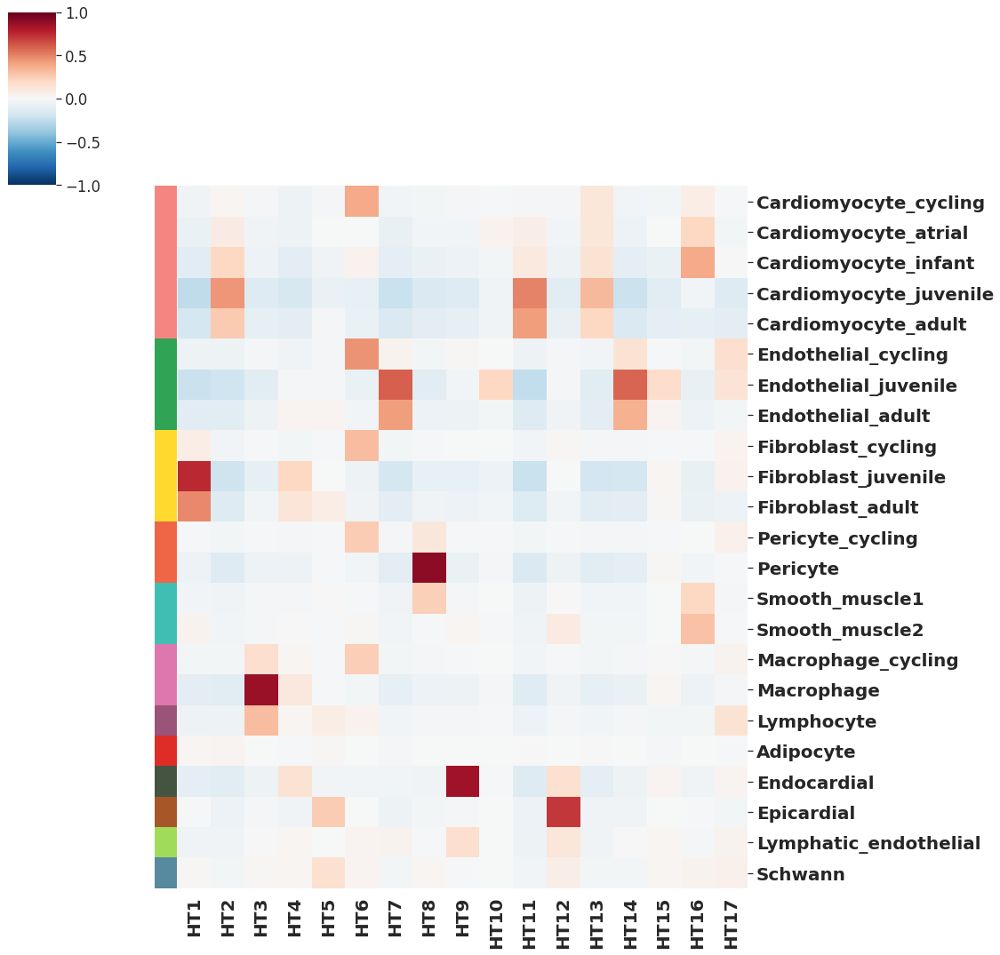

In [83]:
from scipy import stats
import matplotlib.pyplot as plt
import seaborn as sns

datTraits = Topyfic.Analysis.convertDatTraits(analysis_top_model.cell_participation.obs[['subtypes']])

topicsTraitCor = pd.DataFrame(index=analysis_top_model.cell_participation.to_df().columns,
                                      columns=datTraits.columns,
                                      dtype="float")
topicsTraitPvalue = pd.DataFrame(index=analysis_top_model.cell_participation.to_df().columns,
                                         columns=datTraits.columns,
                                         dtype="float")

for i in analysis_top_model.cell_participation.to_df().columns:
    for j in datTraits.columns:
        tmp = stats.pearsonr(analysis_top_model.cell_participation.to_df()[i], datTraits[j], alternative='greater')
        topicsTraitCor.loc[i, j] = tmp[0]
        topicsTraitPvalue.loc[i, j] = tmp[1]

topicsTraitCor = topicsTraitCor.T
topicsTraitCor.index = pd.CategoricalIndex(topicsTraitCor.index, categories=row_color.subtypes.values)
topicsTraitCor.sort_index(level=0, inplace=True)

xlabels = [f"HT{i+1}" for i in range(analysis_top_model.cell_participation.shape[1])]
ylabels = topicsTraitCor.index

sns.set(font_scale=1.5)
res = sns.clustermap(topicsTraitCor, row_colors=row_color['color'].tolist(), cmap='RdBu_r', 
                          vmin=-1, vmax=1, annot_kws={'size': 20, "weight": "bold"},
                          xticklabels=xlabels, yticklabels=ylabels,
                    figsize=(15,15),
                    col_cluster=False, row_cluster=False)
res.ax_heatmap.axes.set_xticklabels(res.ax_heatmap.axes.get_xmajorticklabels(), fontsize=20, fontweight="bold", rotation=90)
res.ax_heatmap.axes.set_yticklabels(res.ax_heatmap.axes.get_ymajorticklabels(), fontsize=20, fontweight="bold")
plt.yticks(rotation=0)
#ax.set_facecolor('white')

plt.savefig("supp_fig6-10/supp_fig9_topictraithmap_heart.pdf", bbox_inches='tight')
plt.show()

# Fig. S9b

In [53]:
metadata = pd.read_csv("../snrna/heart/seurat/heart_Parse_10x_integrated_metadata.csv")

analysis_top_model = Topyfic.read_analysis("../snrna/heart/topyfic/analysis_10x_heart_11_parse_heart_13.p")

my_palette = {'timepoint' : my_palette_timepoint,
              'sex': my_palette_sex,
              'technology': my_palette_tec}

analysis_top_model.colors_topics.index = [f"HT{i+1}" for i in range(analysis_top_model.colors_topics.shape[0])]
analysis_top_model.cell_participation.var.index = [f"HT{i+1}" for i in range(analysis_top_model.cell_participation.shape[1])]



Reading Analysis done!


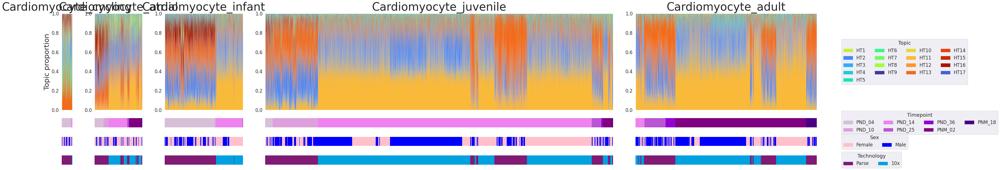

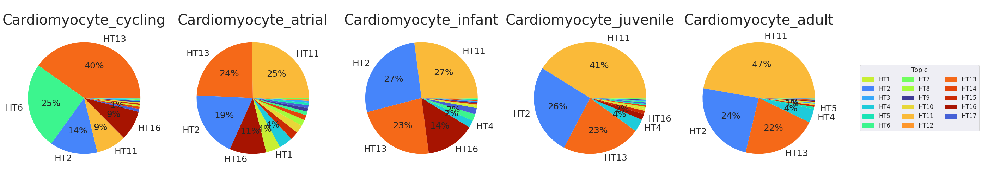

In [54]:
subtypes = ['Cardiomyocyte_cycling', 'Cardiomyocyte_atrial','Cardiomyocyte_infant','Cardiomyocyte_juvenile','Cardiomyocyte_adult']

file_name = "supp_fig6-10/supp_fig9_structure_heart_cm"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig9_pie_heart_cm"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



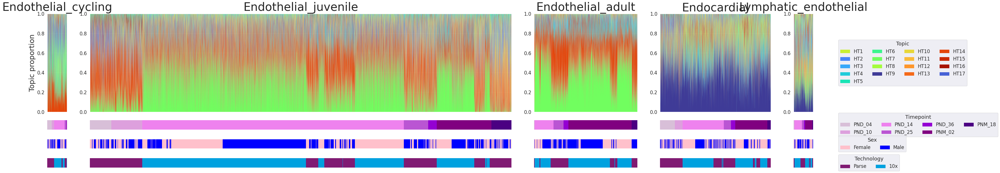

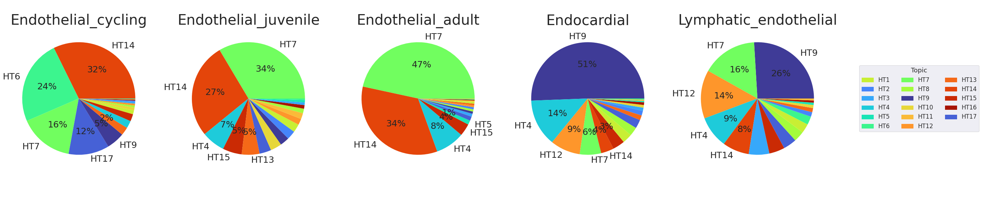

In [55]:
subtypes = ['Endothelial_cycling', 'Endothelial_juvenile','Endothelial_adult','Endocardial','Lymphatic_endothelial']

file_name = "supp_fig6-10/supp_fig9_structure_heart_endo"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig9_pie_heart_endo"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



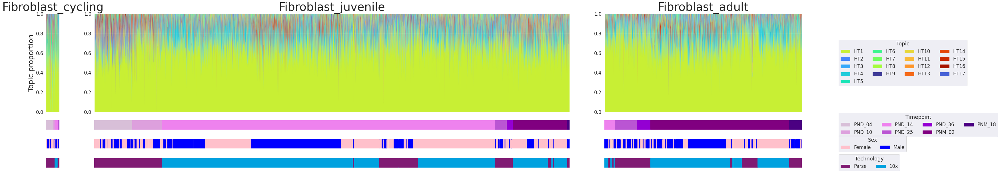

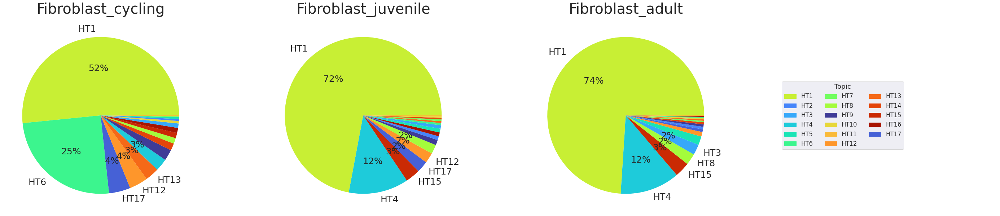

In [56]:
subtypes = ['Fibroblast_cycling', 'Fibroblast_juvenile','Fibroblast_adult']

file_name = "supp_fig6-10/supp_fig9_structure_heart_fibro"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig9_pie_heart_fibro"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



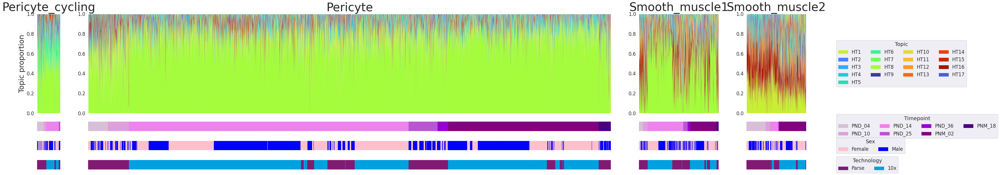

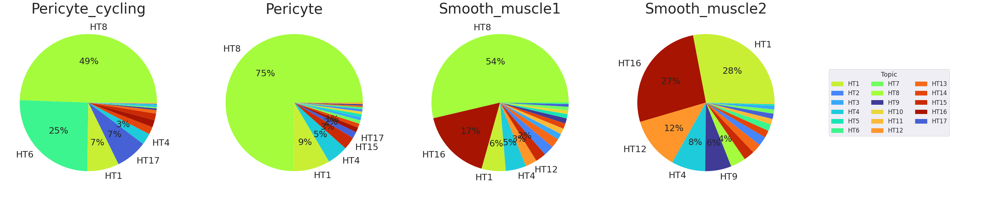

In [57]:
subtypes = ['Pericyte_cycling', 'Pericyte','Smooth_muscle1','Smooth_muscle2']

file_name = "supp_fig6-10/supp_fig9_structure_heart_peri_sm"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig9_pie_heart_peri_sm"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



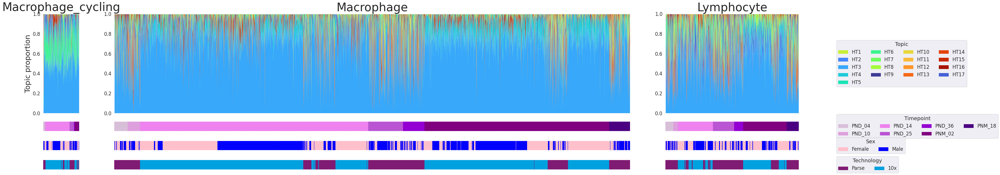

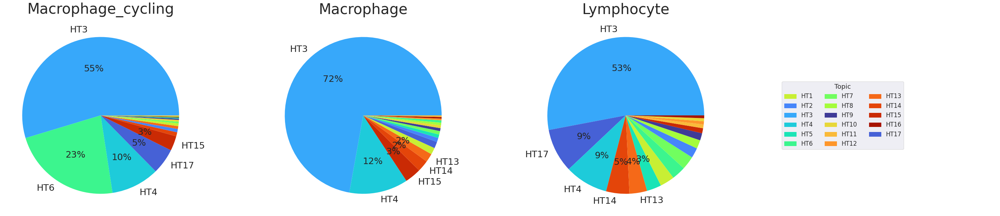

In [58]:
subtypes = ['Macrophage_cycling','Macrophage','Lymphocyte']

file_name = "supp_fig6-10/supp_fig9_structure_heart_immune"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig9_pie_heart_peri_sm"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



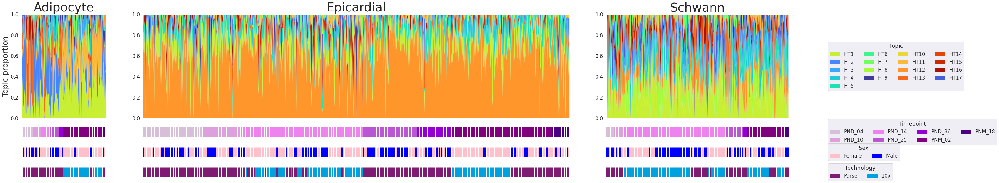

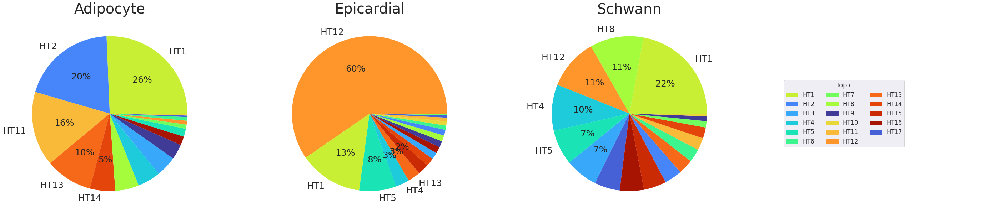

In [59]:
subtypes = ['Adipocyte', 'Epicardial','Schwann']

file_name = "supp_fig6-10/supp_fig9_structure_heart_other"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig9_pie_heart_peri_sm"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



# Fig. S10a

In [99]:
analysis_top_model = Topyfic.read_analysis("../snrna/gastrocnemius/topyfic/analysis_10x_gastrocnemius_12_parse_gastrocnemius_8.p")



Reading Analysis done!


In [100]:
row_color = analysis_top_model.cell_participation.obs[['celltypes', 'subtypes']]
row_color.drop_duplicates(inplace=True)
row_color.reset_index(drop=True, inplace=True)

In [101]:
#row_color.celltypes.value_counts()
#row_color.subtypes.value_counts()

In [102]:
row_color = analysis_top_model.cell_participation.obs[['celltypes', 'subtypes']]
row_color.drop_duplicates(inplace=True)
row_color.reset_index(drop=True, inplace=True)
col = ['Myonuclei',
       'Endothelial',
       'FAP',
       'Tenocyte',
       'Smooth_muscle',
       'Macrophage',
       'Lymphocyte',
       'Adipocyte',
       'Schwann']

row_color.celltypes = pd.Categorical(row_color.celltypes, categories=col)
row_color.sort_values(by='celltypes', axis=0, inplace=True)
row_color.reset_index(drop=True, inplace=True)

row_color.subtypes = pd.Categorical(row_color.subtypes, categories=[
                                                                    'Satellite',
                                                                    'Perinatal',
                                                                    'Type1_Myonuclei',
                                                                    'Type2A_Myonuclei',
                                                                    'Type2B_Myonuclei',
                                                                    'Type2X_Myonuclei',
                                                                    'NMJ',
                                                                    'MTJ',
                                                                    'Endothelial',
                                                                    'FAP',
                                                                    'Tenocyte',
                                                                    'Smooth_muscle',
                                                                    'Macrophage',
                                                                    'Lymphocyte',
                                                                    'Adipocyte',
                                                                    'Schwann'
    
                                                                   ])

color = pd.read_csv("data/enc4_mouse_snrna_celltypes.csv")
row_color['color'] = ""
for i in range(row_color.shape[0]):
    tmp = color.celltype_color[color.celltypes == row_color.loc[i, 'celltypes']].values
    row_color.loc[i, 'color'] = tmp[0]

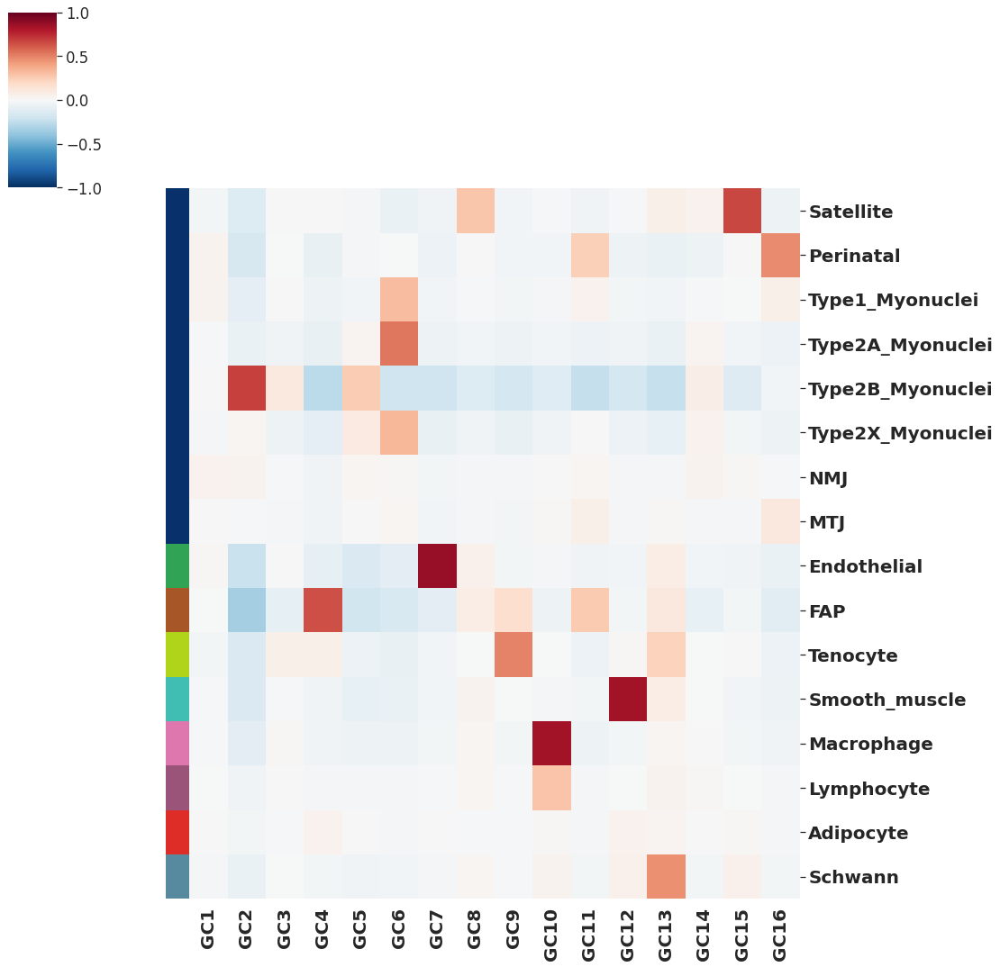

In [103]:
from scipy import stats
import matplotlib.pyplot as plt
import seaborn as sns

datTraits = Topyfic.Analysis.convertDatTraits(analysis_top_model.cell_participation.obs[['subtypes']])

topicsTraitCor = pd.DataFrame(index=analysis_top_model.cell_participation.to_df().columns,
                                      columns=datTraits.columns,
                                      dtype="float")
topicsTraitPvalue = pd.DataFrame(index=analysis_top_model.cell_participation.to_df().columns,
                                         columns=datTraits.columns,
                                         dtype="float")

for i in analysis_top_model.cell_participation.to_df().columns:
    for j in datTraits.columns:
        tmp = stats.pearsonr(analysis_top_model.cell_participation.to_df()[i], datTraits[j], alternative='greater')
        topicsTraitCor.loc[i, j] = tmp[0]
        topicsTraitPvalue.loc[i, j] = tmp[1]

topicsTraitCor = topicsTraitCor.T
topicsTraitCor.index = pd.CategoricalIndex(topicsTraitCor.index, categories=row_color.subtypes.values)
topicsTraitCor.sort_index(level=0, inplace=True)

xlabels = [f"GC{i+1}" for i in range(analysis_top_model.cell_participation.shape[1])]
ylabels = topicsTraitCor.index

sns.set(font_scale=1.5)
res = sns.clustermap(topicsTraitCor, row_colors=row_color['color'].tolist(), cmap='RdBu_r', 
                          vmin=-1, vmax=1, annot_kws={'size': 20, "weight": "bold"},
                          xticklabels=xlabels, yticklabels=ylabels,
                    figsize=(15,15),
                    col_cluster=False, row_cluster=False)
res.ax_heatmap.axes.set_xticklabels(res.ax_heatmap.axes.get_xmajorticklabels(), fontsize=20, fontweight="bold", rotation=90)
res.ax_heatmap.axes.set_yticklabels(res.ax_heatmap.axes.get_ymajorticklabels(), fontsize=20, fontweight="bold")
plt.yticks(rotation=0)
#ax.set_facecolor('white')

plt.savefig("supp_fig6-10/supp_fig10_topictraithmap_gastroc.pdf", bbox_inches='tight')
plt.show()

# Fig. S10b

In [ ]:
metadata = pd.read_csv("../snrna/gastrocnemius/seurat/gastrocnemius_Parse_10x_integrated_metadata.csv")

analysis_top_model = Topyfic.read_analysis("../snrna/gastrocnemius/topyfic/analysis_10x_gastrocnemius_12_parse_gastrocnemius_8.p")

my_palette = {'timepoint' : my_palette_timepoint,
              'sex': my_palette_sex,
              'technology': my_palette_tec}

analysis_top_model.colors_topics.index = [f"GC{i+1}" for i in range(analysis_top_model.colors_topics.shape[0])]
analysis_top_model.cell_participation.var.index = [f"GC{i+1}" for i in range(analysis_top_model.cell_participation.shape[1])]



Reading Analysis done!


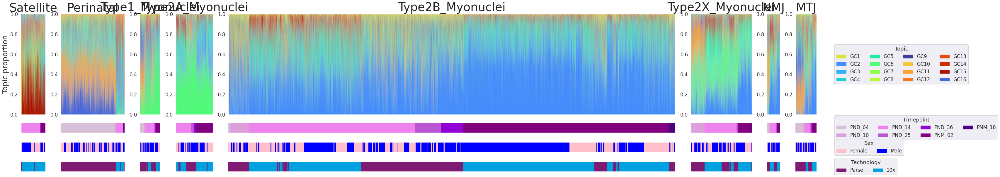

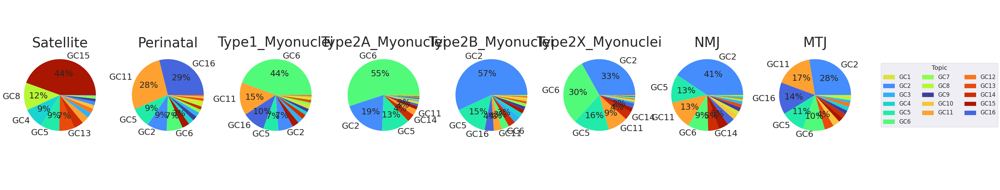

In [92]:
subtypes = ['Satellite', 'Perinatal','Type1_Myonuclei','Type2A_Myonuclei',
            'Type2B_Myonuclei','Type2X_Myonuclei','NMJ','MTJ']

file_name = "supp_fig6-10/supp_fig10_structure_gastroc_myonuclei"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig10_pie_gastroc_myonuclei"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



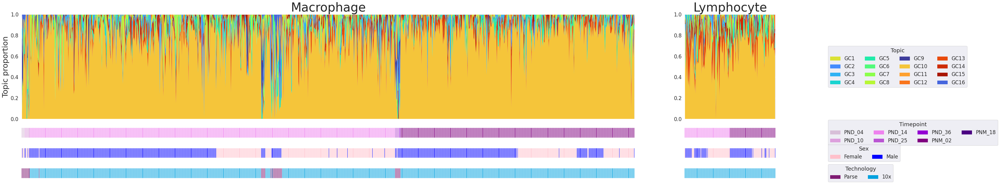

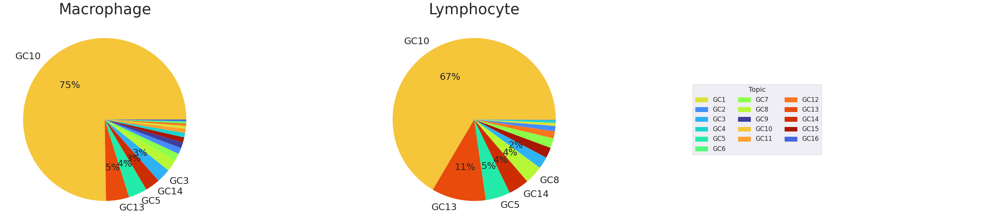

In [93]:
subtypes = ['Macrophage','Lymphocyte']

file_name = "supp_fig6-10/supp_fig10_structure_gastroc_immune"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig10_pie_gastroc_immune"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)



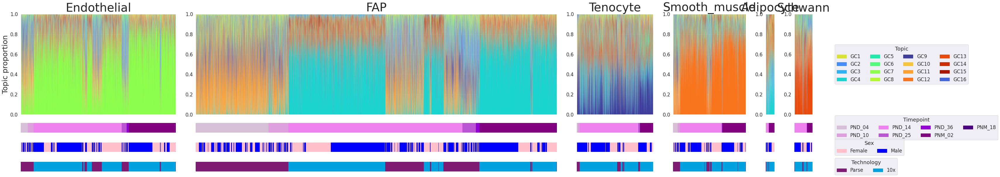

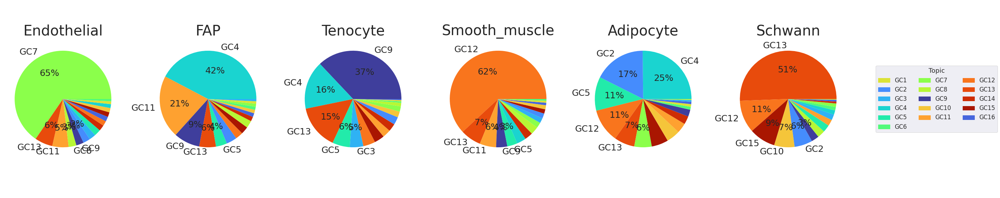

In [94]:
subtypes = ['Endothelial','FAP','Tenocyte','Smooth_muscle','Adipocyte','Schwann']

file_name = "supp_fig6-10/supp_fig10_structure_gastroc_other"
analysis_top_model.structure_plot(level='subtypes',
                                  category=subtypes,
                                  metaData=["timepoint", "sex", "technology"], #"",
                                  metaData_palette=my_palette,
                                  order_cells=["timepoint"],
                                  figsize = (50, 10),
                                  save=True,
                                  show=True,
                                  file_format='pdf',
                                  file_name=file_name)

file_name = "supp_fig6-10/supp_fig10_pie_gastroc_other"
analysis_top_model.pie_structure_Chart(level='subtypes',
                                       category=subtypes,
                                       figsize = (50, 10),
                                       save=True,
                                       show=True,
                                       file_format='pdf',
                                       file_name=file_name)

